In [ ]:
import sys
python = sys.executable # get python executable path
print(python)

for i in ["numpy",  "scipy", "matplotlib", "pandas", "opencv-python", "opencv-contrib-python"]: # declare what packages we need
  print(f"Installing: {i}")
  ! $python -m pip install $i # install packages calling bash command from the notebook, e.g. "/usr/bin/python -m pip install numpy"

import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import urllib.request
from google.colab.patches import cv2_imshow
import cv2

/usr/bin/python3
Installing: numpy
Installing: scipy
Installing: matplotlib
Installing: pandas
Installing: opencv-python
Installing: opencv-contrib-python


Previous Image Keypoints


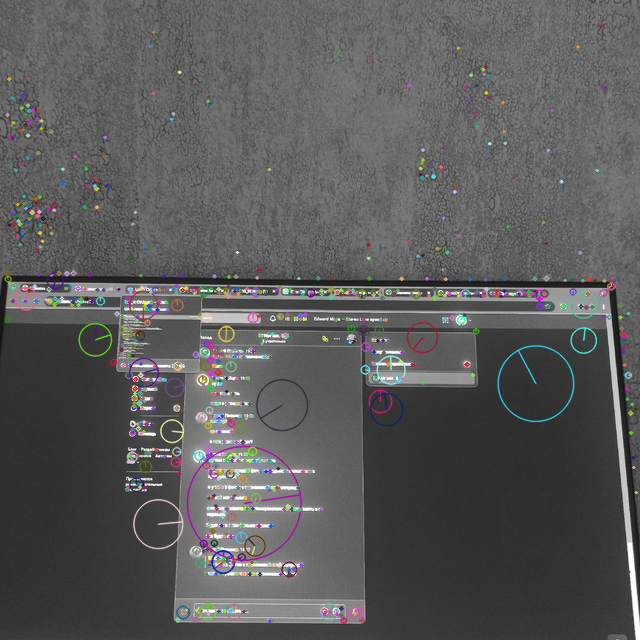

Current Image Keypoints


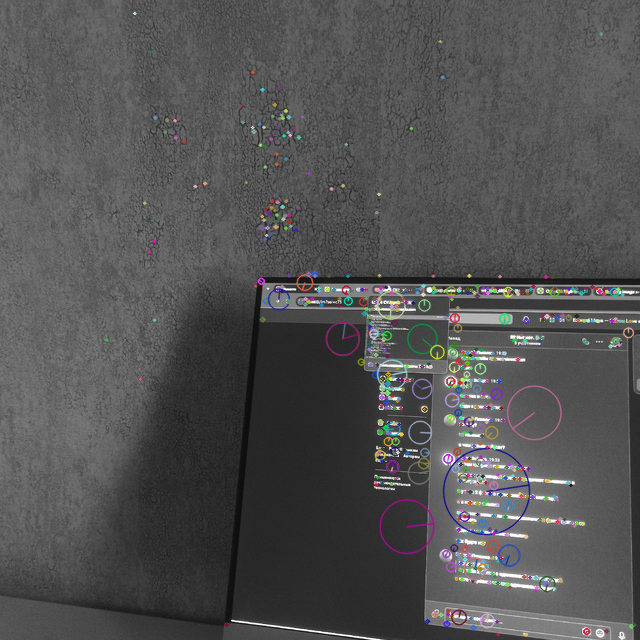

Previous Image Keypoints


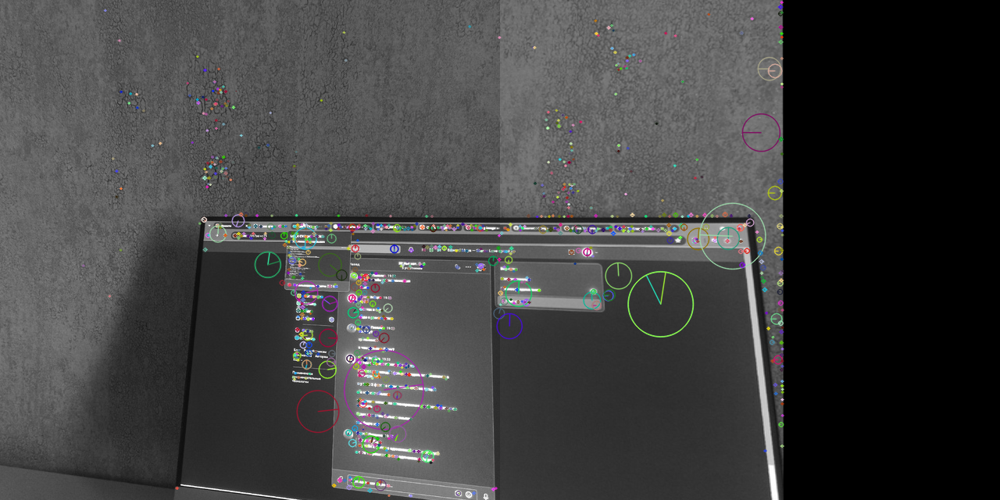

Current Image Keypoints


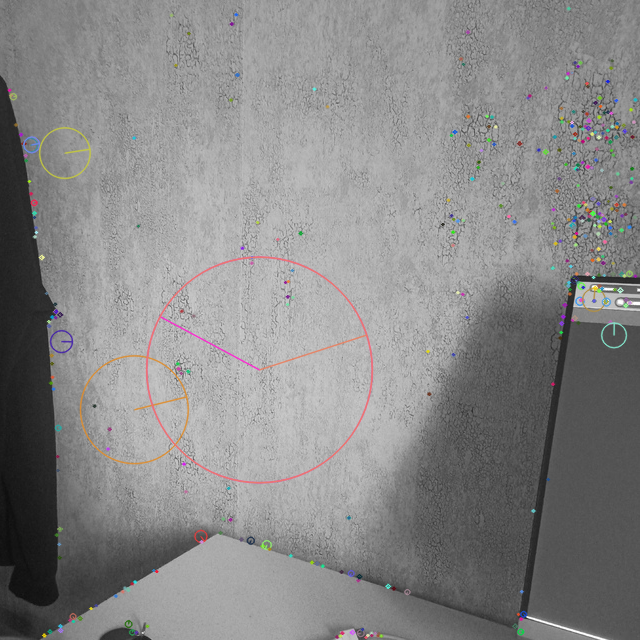

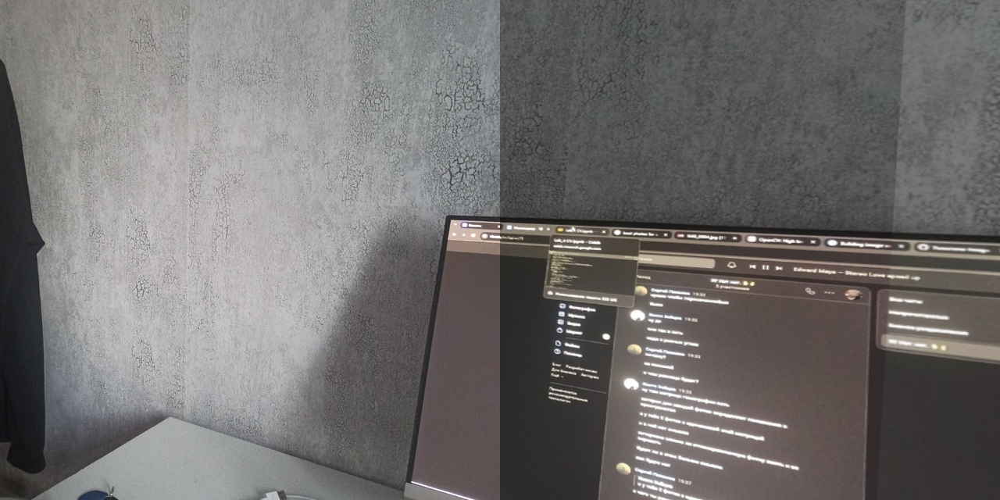

In [ ]:
import cv2
import numpy as np

def resize_image(image, max_size=(640, 640)):

    return image[0:640, -641:-1]

def stitch_images(images):
    if len(images) < 2:
        return None

    images_resized = [resize_image(img) for img in images]

    sift = cv2.SIFT_create()

    prev_image = images_resized[0]
    for i in range(1, len(images_resized)):
        current_image = images_resized[i]

        prev_gray = cv2.cvtColor(prev_image, cv2.COLOR_BGR2GRAY)
        current_gray = cv2.cvtColor(current_image, cv2.COLOR_BGR2GRAY)

        #ключевые точки и дескрипторы
        prev_kp, prev_des = sift.detectAndCompute(prev_gray, None)
        current_kp, current_des = sift.detectAndCompute(current_gray, None)

        prev_image_kp = cv2.drawKeypoints(prev_gray, prev_kp, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
        current_image_kp = cv2.drawKeypoints(current_gray, current_kp, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
        print("Previous Image Keypoints")
        cv2_imshow(prev_image_kp)
        print("Current Image Keypoints")
        cv2_imshow(current_image_kp)

        bf = cv2.BFMatcher()
        matches = bf.knnMatch(prev_des, current_des, k=2)

        #хорошие сопоставления
        good = []
        for m, n in matches:
            if m.distance < 0.75*n.distance:
                good.append(m)

        if len(good) > 4:
            #матрица гомографии
            src_pts = np.float32([prev_kp[m.queryIdx].pt for m in good]).reshape(-1, 1, 2)
            dst_pts = np.float32([current_kp[m.trainIdx].pt for m in good]).reshape(-1, 1, 2)

            M, _ = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, 5.0)

            h, w = current_gray.shape
            warped_image = cv2.warpPerspective(prev_image, M, (w * 2, h))

            warped_image[0:h, 0:w] = current_image
            prev_image = warped_image
        else:
            print("Не достаточно сопоставлений - %d/%d" % (len(good), 4))
            return None

    return prev_image
images = [cv2.imread('image11.jpg'), cv2.imread('image22.jpg'), cv2.imread('image3.jpg')]
panorama = stitch_images(images)

if panorama is not None:
    cv2_imshow(panorama)
else:
    print("Склейка невозможна")

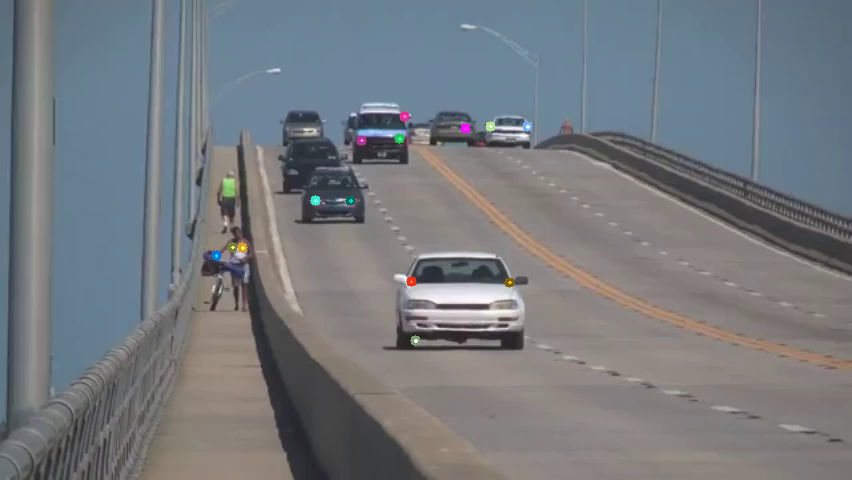

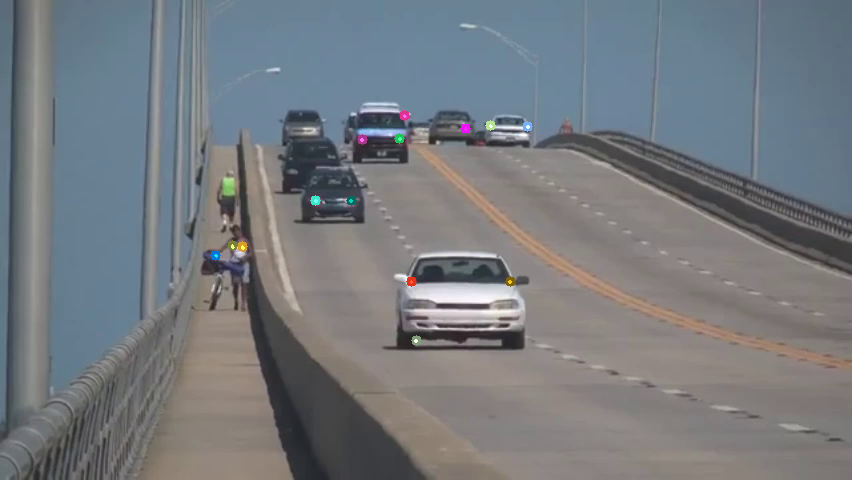

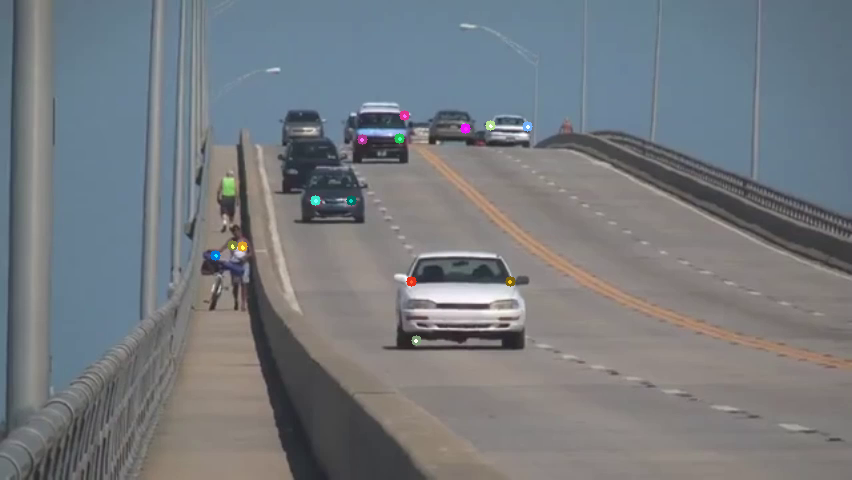

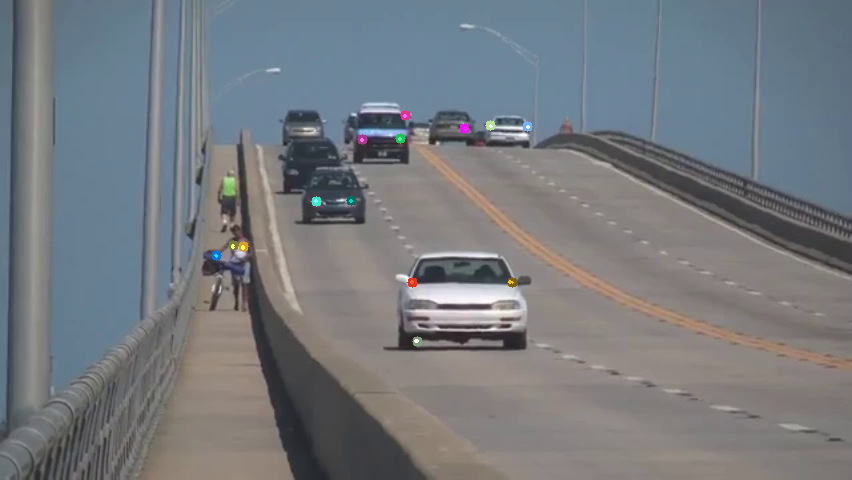

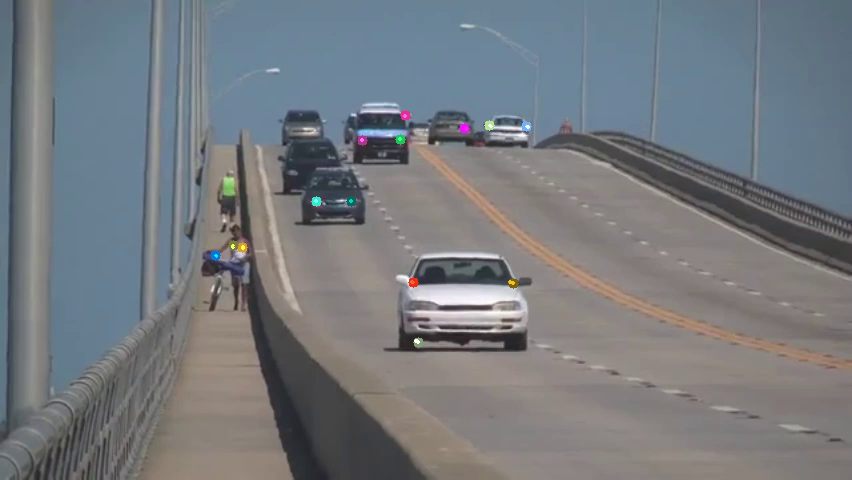

...

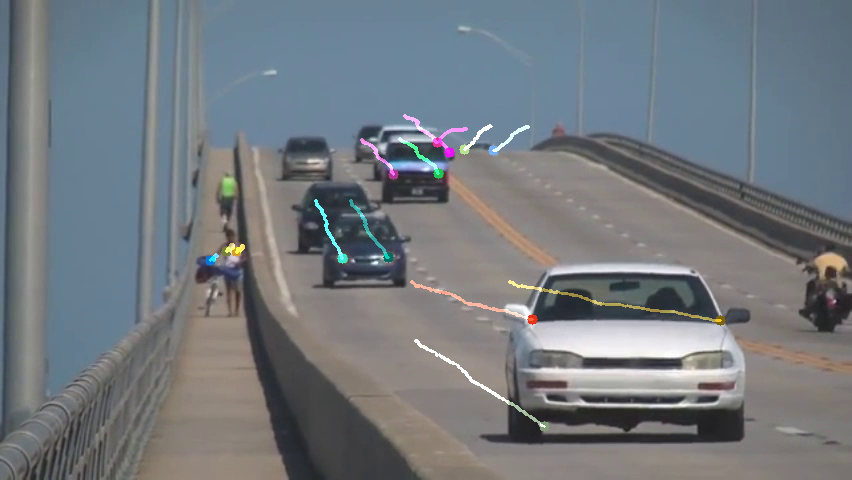

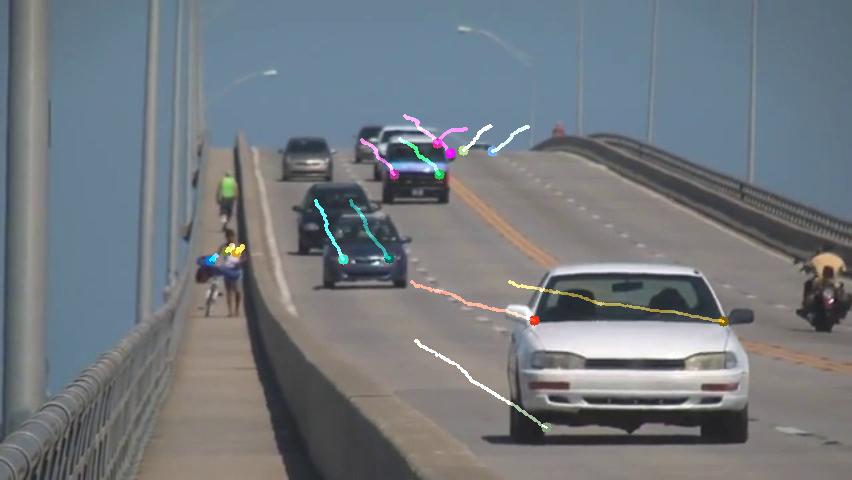

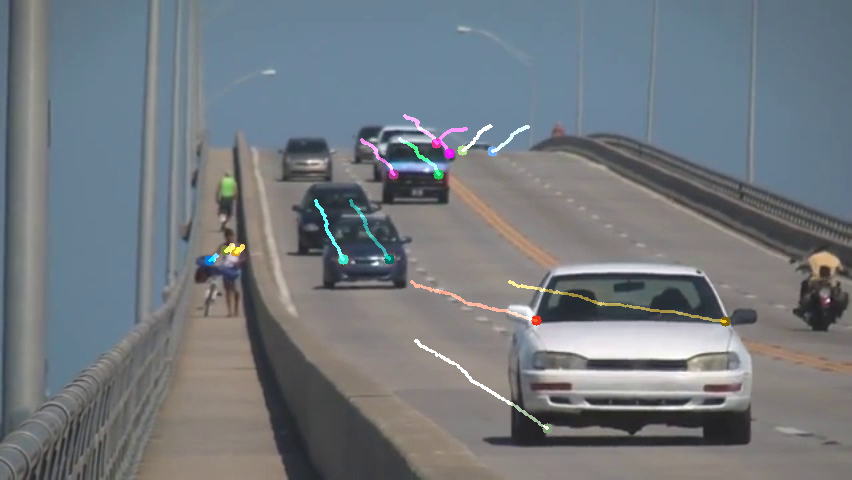

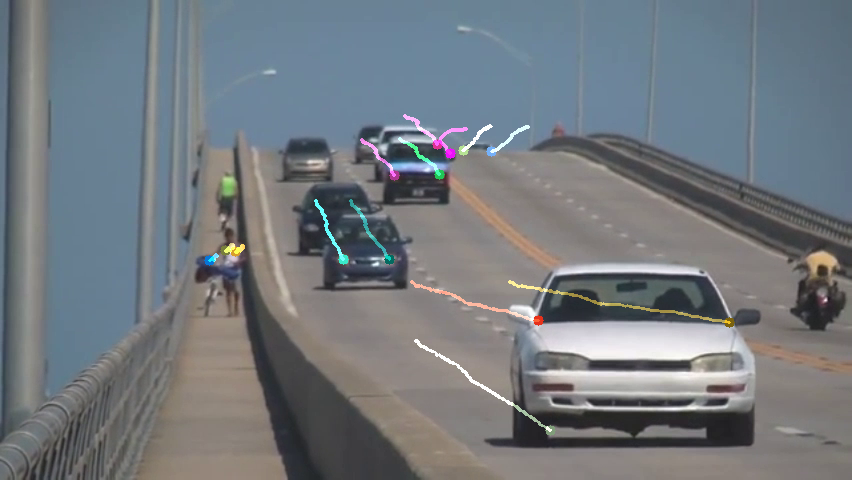

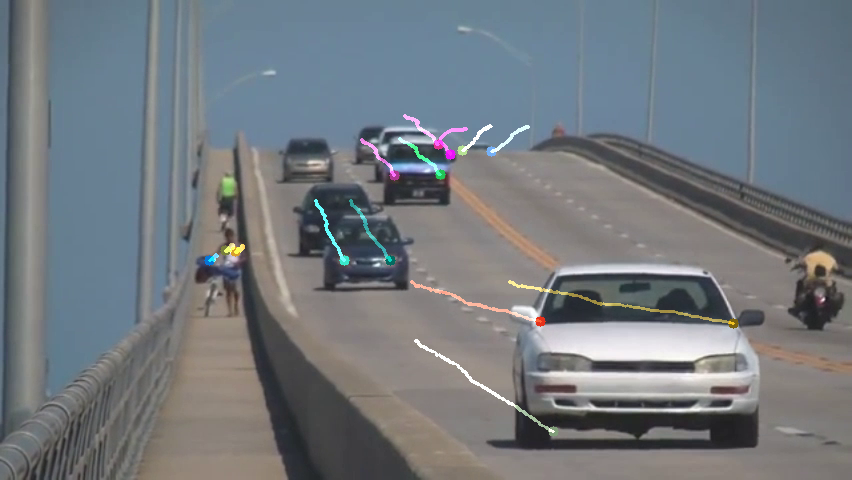

No frames grabbed!


In [ ]:
import numpy as np
cap = cv2.VideoCapture('video.mp4')

feature_params = dict( maxCorners = 100, qualityLevel = 0.3, minDistance = 7, blockSize = 7 )
lk_params = dict( winSize  = (15, 15), maxLevel = 2, criteria = (cv2.TERM_CRITERIA_EPS | cv2.TERM_CRITERIA_COUNT, 10, 0.03))

color = np.random.randint(0, 255, (100, 3))
ret, old_frame = cap.read()
old_gray = cv2.cvtColor(old_frame, cv2.COLOR_BGR2GRAY)
p0 = cv2.goodFeaturesToTrack(old_gray, mask = None, **feature_params)

mask = np.zeros_like(old_frame)

while(1):
  ret, frame = cap.read()
  if not ret:
    print('No frames grabbed!')
    break

  frame_gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

  p1, st, err = cv2.calcOpticalFlowPyrLK(old_gray, frame_gray, p0, None, **lk_params)

  if p1 is not None:
    good_new = p1[st==1]
    good_old = p0[st==1]

  for i, (new, old) in enumerate(zip(good_new, good_old)):
    a, b = new.ravel()
    c, d = old.ravel()
    mask = cv2.line(mask, (int(a), int(b)), (int(c), int(d)), color[i].tolist(), 2)
    frame = cv2.circle(frame, (int(a), int(b)), 5, color[i].tolist(), -1)
  img = cv2.add(frame, mask)

  cv2_imshow( img)
  k = cv2.waitKey(30)
  if k == 27:
    break

  old_gray = frame_gray.copy()
  p0 = good_new.reshape(-1, 1, 2)